# Library loading

In [1]:
import scanpy as sc, anndata as ad, numpy as np, pandas as pd
from scipy import sparse
from anndata import AnnData
import warnings
import socket
import seaborn as sns
import holoviews as hv
import plotly.express as px
import random
import matplotlib.ticker as ticker

random.seed(0)
from matplotlib import pylab

In [2]:
from matplotlib import *
import sys
import yaml
import os
from pandas.api.types import CategoricalDtype
import plotly
import scanpy.external as sce
random.seed(0)

import matplotlib.pyplot as plt

warnings.filterwarnings('ignore')

In [3]:
plotly.offline.init_notebook_mode()

In [4]:
import matplotlib.pyplot as plt


In [5]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [6]:
%matplotlib inline

In [7]:
sc.settings.verbosity = 3         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=50, facecolor='white', dpi_save=700)
pylab.rcParams['figure.figsize'] = (9, 9)
figDir = "./figures"


scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.6.3 pandas==1.2.4 scikit-learn==0.24.2 statsmodels==0.13.1 python-igraph==0.9.8 louvain==0.7.1 pynndescent==0.5.5


In [8]:
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [9]:
anndata2ri.activate()

In [10]:
%load_ext rpy2.ipython

### Configure paths

In [11]:
hostRoot = "-".join(socket.gethostname().split('-')[0:2])

with open(os.path.expanduser('~')+"/paths_config.yaml", 'r') as f:
    paths = yaml.load(f, Loader=yaml.FullLoader)

#indir=paths["paths"]["indir"][hostRoot]
outdir="./outdir"
#projectBaseDir=paths["paths"]["projectBaseDir"][hostRoot]
markers = "./data/resources/F_T.markers.scored.plot.tsv"
CuratedmarkersDF = pd.read_csv(markers, header=None, sep = "\t", names=["name","area","score"])

leiden3Mapping = {"0":"Encs-1",
"1":"CBC/BRCs-1",
"2":"EXN-1",
"3":"EnCs-2",
"4":"RGCs-1",
"5":"RGCs-2",
"6":"ccRGCs",
"7":"inPCs",
"8":"EXN-2",
"9":"RtCs",
"10":"ER-Cs",
"11":"CBC/BRCs-2"}

In [12]:
adataAll = sc.read_h5ad(outdir+"/3_polaroid_quickAnno.h5ad")

adataAll.obs["leidenAnno"] =  adataAll.obs["leiden0.3"].replace(leiden3Mapping).astype("category").cat.reorder_categories(list(leiden3Mapping.values()))
adataAll.uns["leidenAnno_colors"] = adataAll.uns["leiden0.3_colors"].copy()



# Paga 

In [13]:
adataPaga = adataAll.copy()


In [14]:
sc.tl.paga(adataPaga, groups="leidenAnno", use_rna_velocity=False)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


In [15]:
groups="leidenAnno"
basis="X_umap"
if 'embeddings' in globals():
    del embeddings
for l in adataPaga.obs[groups].cat.categories:
    test=adataPaga.obsm[basis][adataPaga.obs[groups] == l]
    x=np.mean(test[:,0])
    y=np.mean(test[:,1])
    if not 'embeddings' in globals():
        embeddings = np.array([x,y])
    else:
        embeddings=np.vstack([embeddings,np.array([x,y])])

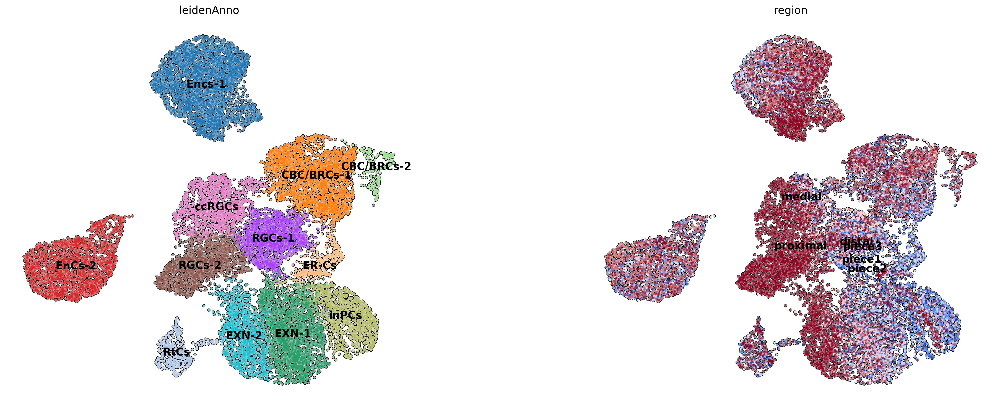

In [16]:
sc.pl.umap(adataPaga, color = ["leidenAnno","region"],ncols=2, 
           size = 30,add_outline=True, outline_width=(0.2, 0.05), vmin='p2',vmax='p98', legend_fontsize="medium", frameon=False, wspace=.3, legend_loc="on data")


--> added 'pos', the PAGA positions (adata.uns['paga'])


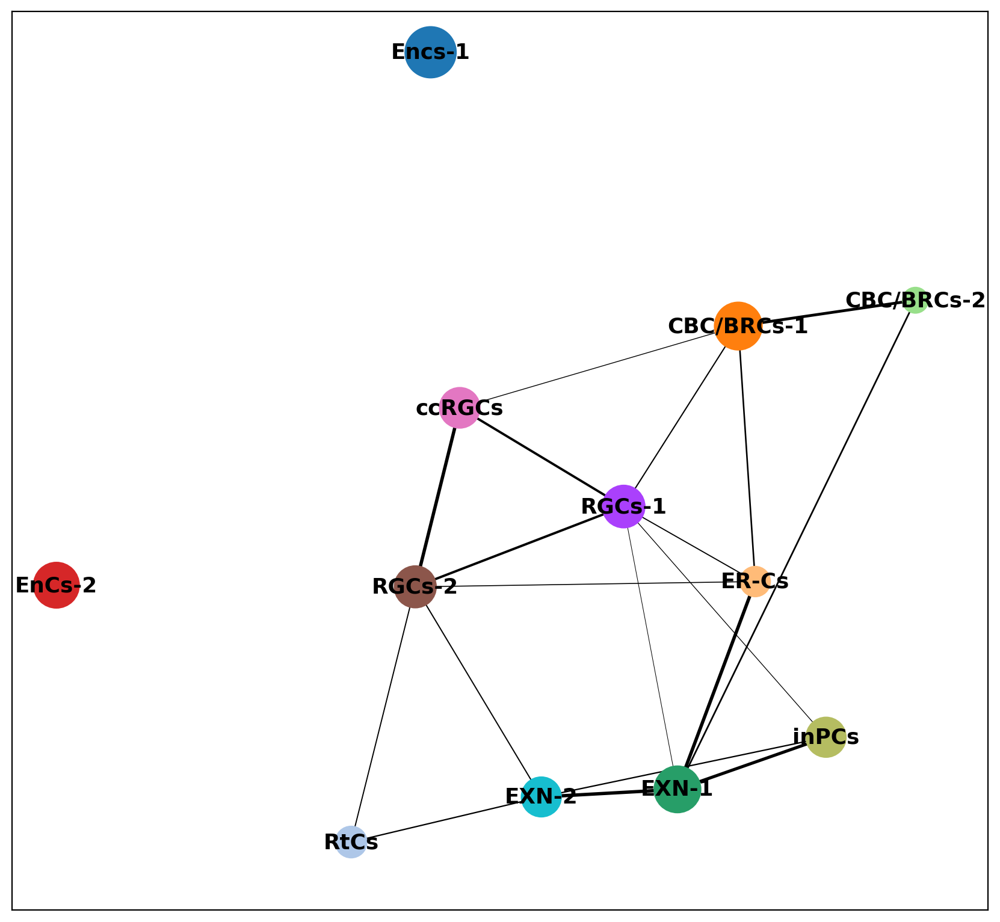

In [17]:
thresholdPagaEdges = 0.04
sc.pl.paga(adataPaga, pos=embeddings, max_edge_width=2, threshold = thresholdPagaEdges, color = "leidenAnno", node_size_scale=4, save="Paga.svg")

## Shortest paths

[6, 4, 2]


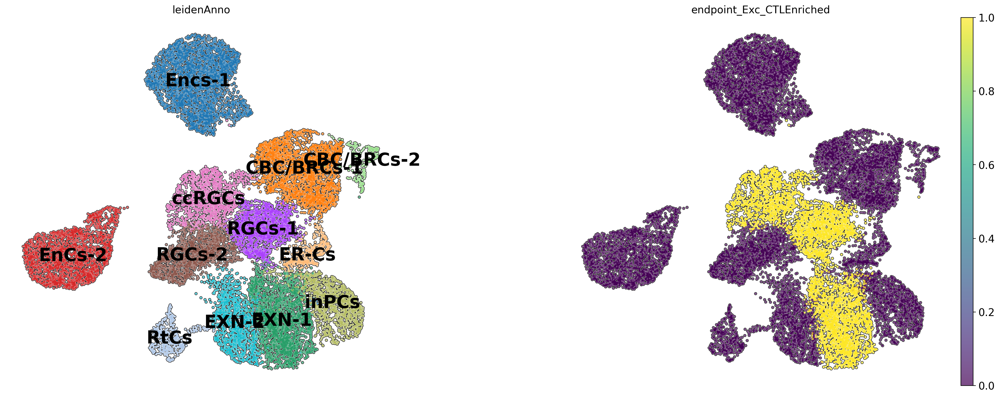

[6, 5, 8]


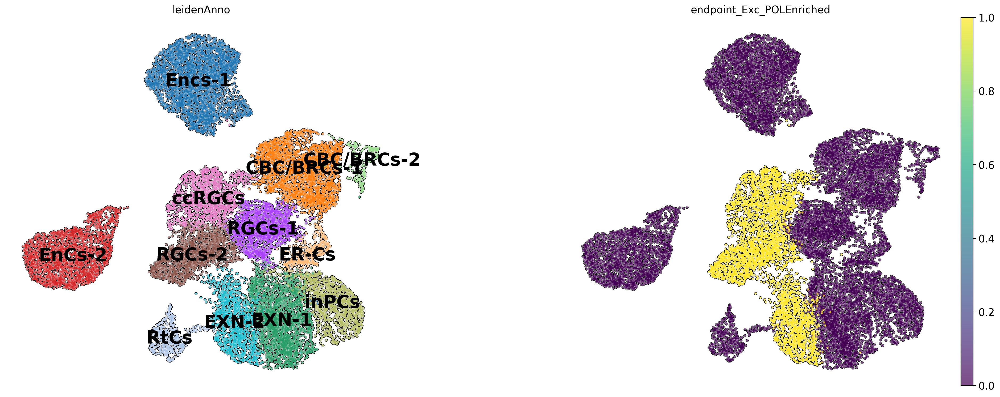

In [18]:
# Setting terminal states from leiden + annotation
AnnoCategories = adataPaga.obs["leidenAnno"].cat.categories.tolist()

endPointsMap = {"Exc_CTLEnriched":AnnoCategories.index("EXN-1"),
 "Exc_POLEnriched":AnnoCategories.index("EXN-2"),
}

root = adataPaga.obs["leidenAnno"].cat.categories.tolist().index("ccRGCs")

import networkx as nx
testGraph = nx.from_numpy_matrix(adataPaga.uns["paga"]["connectivities"].todense(), parallel_edges=False, create_using=None )
testGraph.remove_edges_from([(n1, n2) for n1, n2, w in testGraph.edges(data="weight") if w < thresholdPagaEdges])
for t in testGraph.edges(data="weight"):
    testGraph[t[0]][t[1]]["weight"] = 1-t[2]

for endpoint in list(endPointsMap.keys()):
    sp = nx.shortest_path(testGraph, source=root, target=endPointsMap[endpoint], weight="weight", method='bellman-ford')
    print(sp)
    
    
    #adataMilo_vel.obs["endpoint_"+endpoint] = False
    adataPaga.obs["endpoint_"+str(endpoint)] = adataPaga.obs["leidenAnno"].isin([AnnoCategories[i] for i in sp]).astype(int)
    
    
    

    #pd.DataFrame(adataPaga[adataPaga.obs["endpoint_"+str(endpoint)] == 1].obs_names, columns=["barcode"]).to_csv(outdir+"/"+endpoint+".PagaTest_copy.tsv", )
    sc.pl.umap(adataPaga, color = ["leidenAnno","endpoint_"+str(endpoint)],ncols=3, 
           size = 30,add_outline=True, outline_width=(0.2, 0.05), vmin='p2',vmax='p98', legend_fontsize="xx-large", frameon=False, wspace=.3, legend_loc="on data")

--> added 'pos', the PAGA positions (adata.uns['paga'])


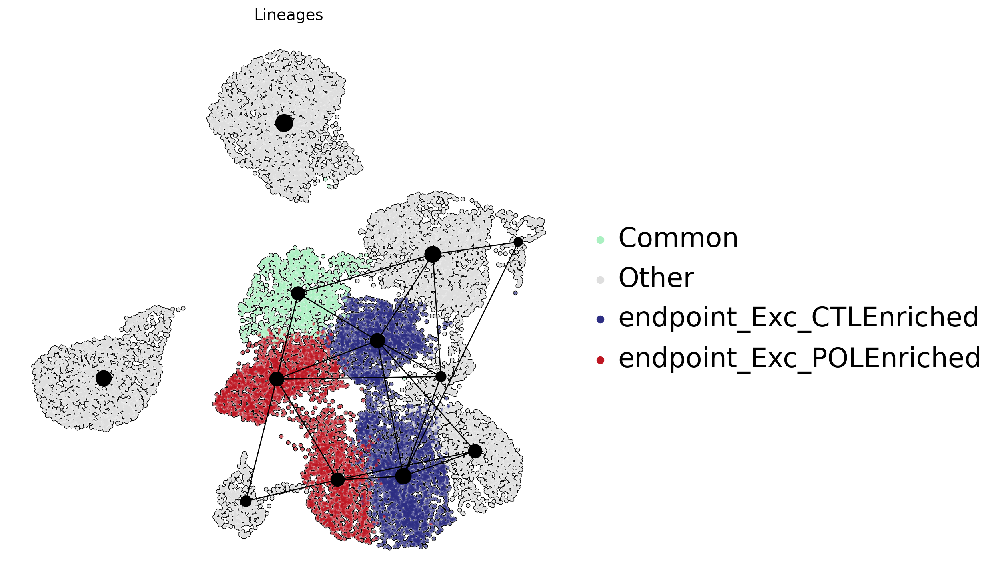

In [19]:
L0 = adataPaga.obs["endpoint_Exc_CTLEnriched"]
L1= adataPaga.obs["endpoint_Exc_POLEnriched"].replace({1:"endpoint_Exc_POLEnriched",0:"Other"})
L1.loc[L0 != 0] = "endpoint_Exc_CTLEnriched"
L1.loc[adataPaga.obs["endpoint_Exc_CTLEnriched"] + adataPaga.obs["endpoint_Exc_POLEnriched"] == 2] = "Common"
adataPaga.obs["Lineages"] = L1

adataPaga.obs["Lineages"] = adataPaga.obs["Lineages"].astype("category")


ColorDict = {"Common":"#AAF0C1",
             "Other":"#dedede",
             "endpoint_Exc_CTLEnriched":"#2d2e83",
             "endpoint_Exc_POLEnriched":"#be1622"}


adataPaga.uns["Lineages_colors"] = [ColorDict[i] for i in adataPaga.obs.Lineages.cat.categories.tolist()]


fig, ax = plt.subplots()

sc.pl.umap(adataPaga, color = "Lineages",
           size = 30,add_outline=True, outline_width=(0.2, 0.05), vmin='p2',vmax='p98', legend_fontsize="xx-large", frameon=False, wspace=.3,
          show=False, ax=ax)

sc.pl.paga(adataPaga, pos=embeddings, min_edge_width=1, max_edge_width=1,fontsize=-1000,fontoutline=0,
           threshold = thresholdPagaEdges, node_size_scale=1, ax=ax,color="black")

In [20]:
ColorDict = {"Common":"#AAF0C1",
             "Other":"dedede",
             "endpoint_Exc_CTLEnriched":"#be1622",
             "endpoint_Exc_POLEnriched":"#2d2e83"}

adataPaga.uns["Lineages_colors"] = [ColorDict[i] for i in adataPaga.obs.Lineages.cat.categories.tolist()]

# Subsetting the interesting branhces

In [21]:
adata = adataAll.raw.to_adata().copy()[adataPaga[adataPaga.obs["endpoint_Exc_CTLEnriched"] + adataPaga.obs["endpoint_Exc_POLEnriched"] >= 1].obs_names].copy()
adata

AnnData object with n_obs × n_vars = 8179 × 28371
    obs: 'dataset', 'organoid', 'region', 'type', 'type_region', 'regionContrast', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'is.Stressed', 'leiden0.3', 'leidenAnno'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable'
    uns: 'dataset_colors', 'dendrogram_leidenAnno', 'diffmap_evals', 'draw_graph', 'is.Stressed_colors', 'leiden', 'leiden0.3_colors', 'leidenAnno_colors', 'neighbors', 'organoid_colors', 'pca', 'rank_genes_groups', 'regionContrast_colors', 'region_colors', 'type_colors', 'umap'
    obsm: 'X_diffmap', 'X_draw_graph_fa', 'X_pca', 'X_umap'

# Re HVGs

## Vertical intersection

In [22]:
# Given the epxloratory phase as many genes were retained
VERTICAL_HVGs = {}
for group in adata.obs.type_region.unique():
    adata_group = adata[adata.obs.type_region == group].copy()
    HVGsDF = sc.pp.highly_variable_genes(adata_group, min_mean=0.0125, max_mean=3, min_disp=0.5, inplace=False, batch_key="organoid")
    VERTICAL_HVGs[group]  = set(HVGsDF[HVGsDF["highly_variable_nbatches"] == 3].index)
    
VERTICAL_HVGs = set.union(*list(VERTICAL_HVGs.values()))


extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)


In [23]:
len(VERTICAL_HVGs)

3069

## Horizontal intersection

In [24]:
import itertools

# Setting up contrasts
proximal = ["polaroid1_proximal","polaroid2_proximal","polaroid3_proximal"]
medial = ["polaroid1_medial","polaroid2_medial","polaroid3_medial"]
distal = ["polaroid1_distal","polaroid2_distal","polaroid3_distal"]

p1 = ["control1_piece1","control2_piece1","control3_piece1"]
p2 = ["control1_piece2","control2_piece2","control3_piece2"]
p3 = ["control1_piece3","control2_piece3","control3_piece3"]

proximal_vs_medial  = list(itertools.product(proximal, medial))
medial_vs_distal  = list(itertools.product(medial, distal))

p1_vs_p2 = list(itertools.product(p1, p2))
p2_vs_p3 = list(itertools.product(p2, p3))



In [25]:
HORIZONTAL_HVGs = {}


# Proximal vs distal regions
# Proximal vs distal regions
# Proximal vs distal regions

In [26]:
proximal_vs_medial_HVGs = {}

for contrast in proximal_vs_medial:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    proximal_vs_medial_HVGs["_".join(contrast)] = HVGs

proximal_vs_medial_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(proximal_vs_medial_HVGs.values())])))
proximal_vs_medial_HVGs = set(proximal_vs_medial_HVGs.value_counts()[proximal_vs_medial_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["proximal_vs_medial_HVGs"] = proximal_vs_medial_HVGs

    
# medial vs distal regions
# medial vs distal regions
# medial vs distal regions

medial_vs_distal_HVGs = {}

for contrast in medial_vs_distal:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    
    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    medial_vs_distal_HVGs["_".join(contrast)] = HVGs

medial_vs_distal_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(medial_vs_distal_HVGs.values())])))
medial_vs_distal_HVGs = set(medial_vs_distal_HVGs.value_counts()[medial_vs_distal_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["medial_vs_distal_HVGs"] = medial_vs_distal_HVGs


# P1 vs P2
# P1 vs P2
# P1 vs P2

p1_vs_p2_HVGs = {}

for contrast in p1_vs_p2:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())
    
    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    p1_vs_p2_HVGs["_".join(contrast)] = HVGs

p1_vs_p2_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(p1_vs_p2_HVGs.values())])))
p1_vs_p2_HVGs = set(p1_vs_p2_HVGs.value_counts()[p1_vs_p2_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["p1_vs_p2_HVGs"] = p1_vs_p2_HVGs



# P2 vs P3
# P2 vs P3
# P2 vs P3

p2_vs_p3_HVGs = {}

for contrast in p2_vs_p3:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    p2_vs_p3_HVGs["_".join(contrast)] = HVGs

p2_vs_p3_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(p2_vs_p3_HVGs.values())])))
p2_vs_p3_HVGs = set(p2_vs_p3_HVGs.value_counts()[p2_vs_p3_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["p2_vs_p3_HVGs"] = p2_vs_p3_HVGs

polaroid1_proximal    1376
polaroid1_medial       297
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid1_proximal    1376
polaroid2_medial       147
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid1_proximal    1376
polaroid3_medial        78
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid2_pro

## Combine all HVGs

In [27]:
HORIZONTAL_HVGs = set.union(*list(HORIZONTAL_HVGs.values()))

In [28]:
JointHVGs = list(HORIZONTAL_HVGs.union(VERTICAL_HVGs))

In [29]:
adata.var["highly_variable"] = adata.var_names.isin(JointHVGs)

In [30]:
adata.var["highly_variable"].sum()

3080

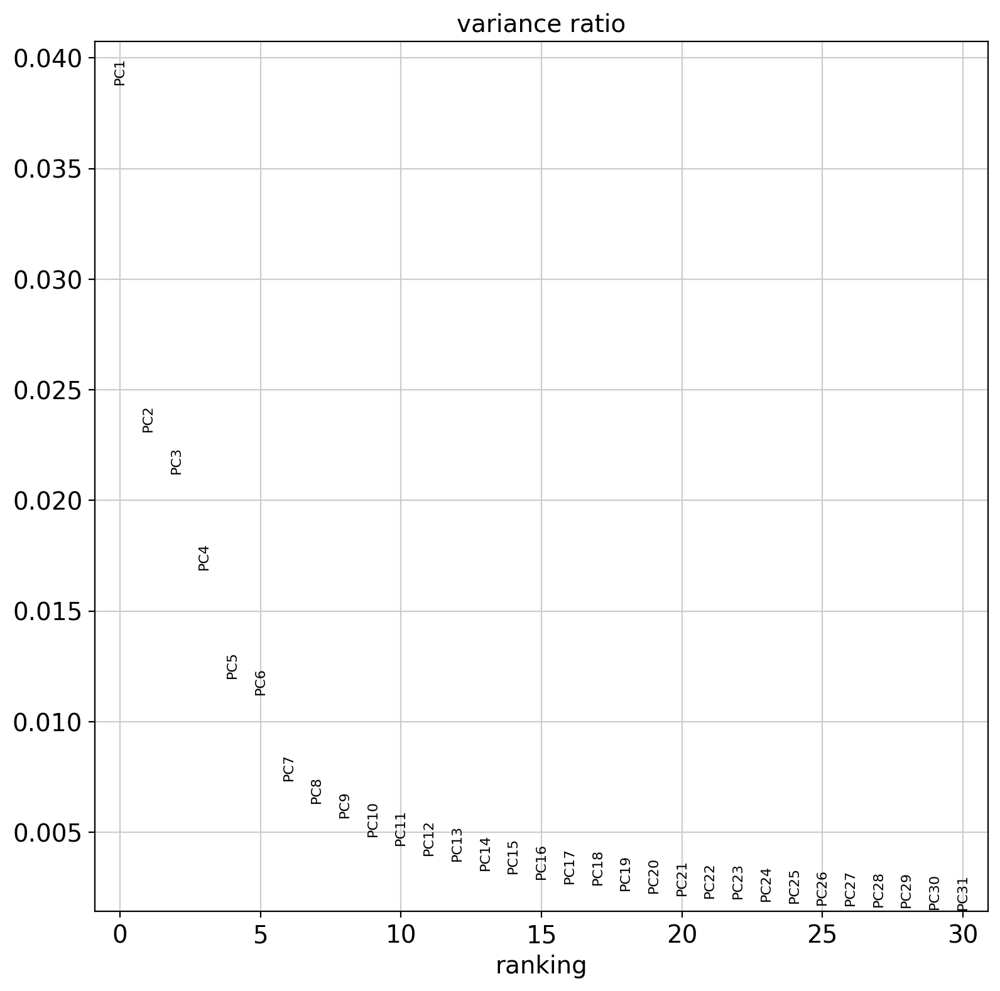

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


In [31]:
# sc.pp.pca(adata, use_highly_variable=True)

sc.pl.pca_variance_ratio(adata)

sc.pp.neighbors(adata, n_neighbors=50, n_pcs=10)
#sc.pp.neighbors(adata, n_neighbors=100, n_pcs=6)



# DPT

In [32]:
# Subsetting to isolate the 2 interesting lineages


sc.tl.diffmap(adata)



RootName = adata.obs_names[adata[:, ["TOP2A"]].X.argmax()]
root_idx = np.where(adata.obs_names == RootName)[0][0]
adata.uns['iroot'] = root_idx
sc.tl.dpt(adata)
sc.tl.draw_graph(adata, n_jobs=4)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9951166  0.9866948  0.98524725 0.97499144 0.9682566
     0.967585   0.95593596 0.9554492  0.95224106 0.94357604 0.9408256
     0.9377395  0.93302083 0.9313617 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:50)


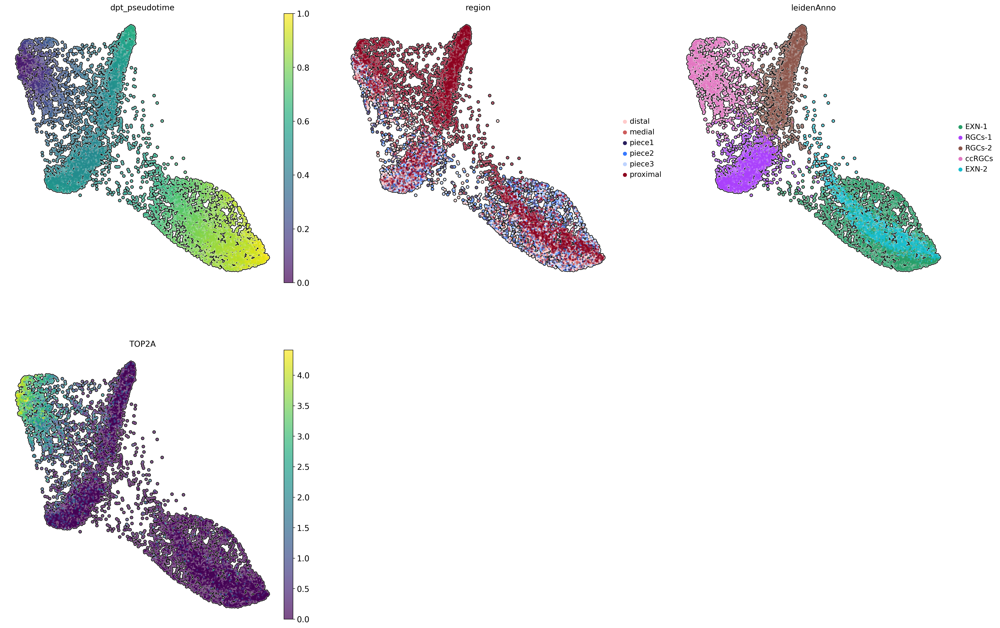

In [33]:
sc.settings.set_figure_params(dpi=50, facecolor='white')
pylab.rcParams['figure.figsize'] = (9, 9)
sc.pl.draw_graph(adata, color=["dpt_pseudotime","region","leidenAnno","TOP2A"], ncols=3, size=50, add_outline=True, frameon=False)

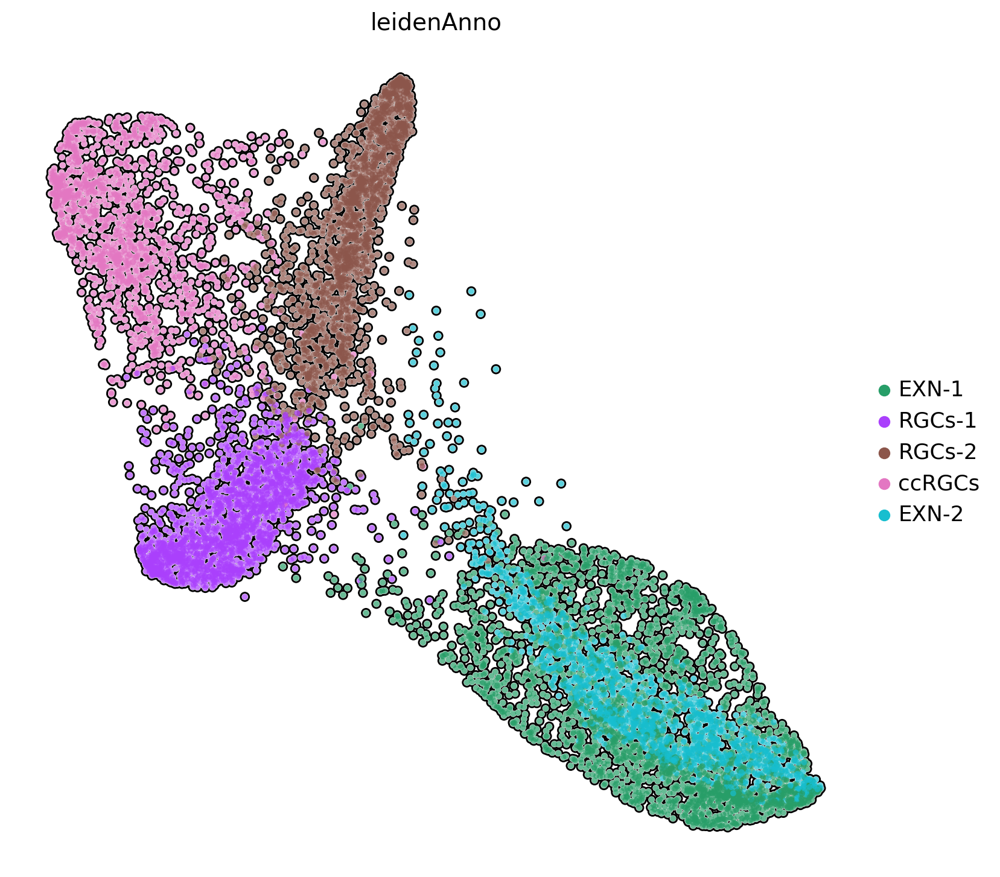

In [34]:
sc.pl.draw_graph(adata, color=["leidenAnno"], ncols=3, size=50, add_outline=True, frameon=False, save="DG_neurogenesis.DA")

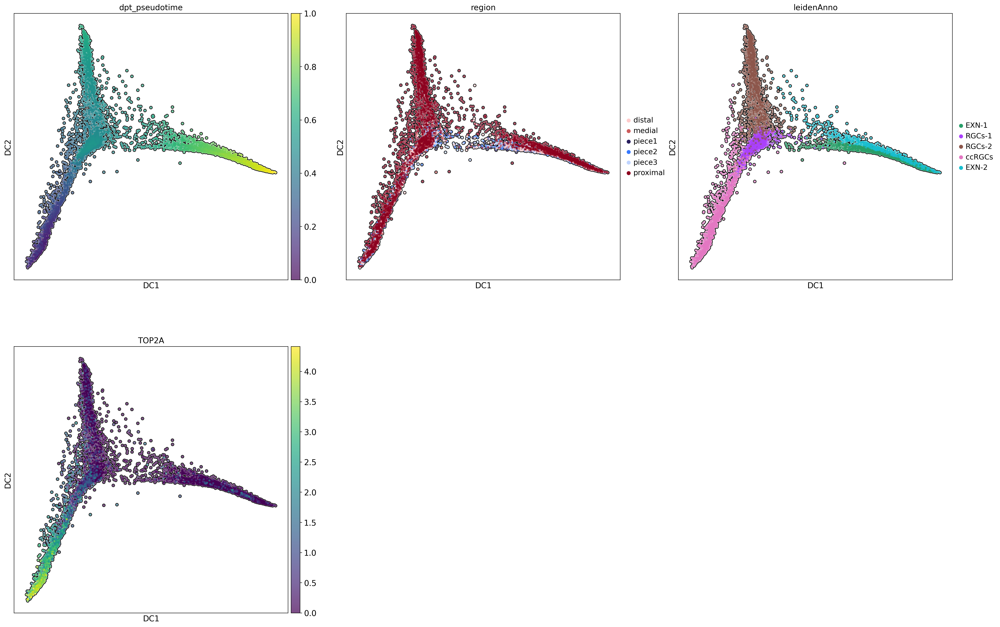

In [35]:
sc.pl.diffmap(adata, color=["dpt_pseudotime","region","leidenAnno","TOP2A"], ncols=3, size=50, add_outline=True,components=(1,2))

# Diffabundance

In [36]:
adata.obs["regionContrast"] = adata.obs["region"].copy()
adata.obs["regionContrast"] = adata.obs["regionContrast"].replace({"piece2":"other","piece1":"other","piece3":"other","medial":"other","distal":"other"})

In [37]:
adata.obs["regionContrast"].value_counts()

other       4557
proximal    3622
Name: regionContrast, dtype: int64

In [38]:
#Adata
adata_no_knn_all = adata.copy()

ssBy = "regionContrast"

TargetCells = adata_no_knn_all.obs[ssBy].value_counts().min()
nl = [random.sample(adata_no_knn_all.obs_names[adata_no_knn_all.obs[ssBy] == d].tolist(),TargetCells) for d in adata_no_knn_all.obs[ssBy].unique()]
adata_no_knn_all = adata_no_knn_all[[item for sublist in nl for item in sublist]].copy()


adata_no_knn_all.obsp = None
adata_no_knn_all.uns.pop("neighbors")
#adata_no_knn_all.X = adata_no_knn_all.X.todense()
print(adata_no_knn_all.obs["regionContrast"].value_counts())

for c in ["organoid","type","regionContrast"]:
    adata_no_knn_all.obs[c] = adata_no_knn_all.obs[c].astype("category")

    
adata_no_knn_all.obsm["DM"] = adata[adata_no_knn_all.obs_names].obsm["X_diffmap"][:,[1,2]].copy()

# DesignMAtrix
design_df = adata_no_knn_all.obs[["dataset","type","regionContrast"]]
design_df.drop_duplicates(inplace=True)
design_df.index = design_df['dataset']
design_df

other       3622
proximal    3622
Name: regionContrast, dtype: int64


,dataset,type,regionContrast
dataset,,,
polaroid2_medial,polaroid2_medial,polaroid,other
polaroid1_distal,polaroid1_distal,polaroid,other
control3_piece2,control3_piece2,control,other
control3_piece3,control3_piece3,control,other
polaroid2_distal,polaroid2_distal,polaroid,other
polaroid3_distal,polaroid3_distal,polaroid,other
control2_piece1,control2_piece1,control,other
control1_piece2,control1_piece2,control,other
control3_piece1,control3_piece1,control,other


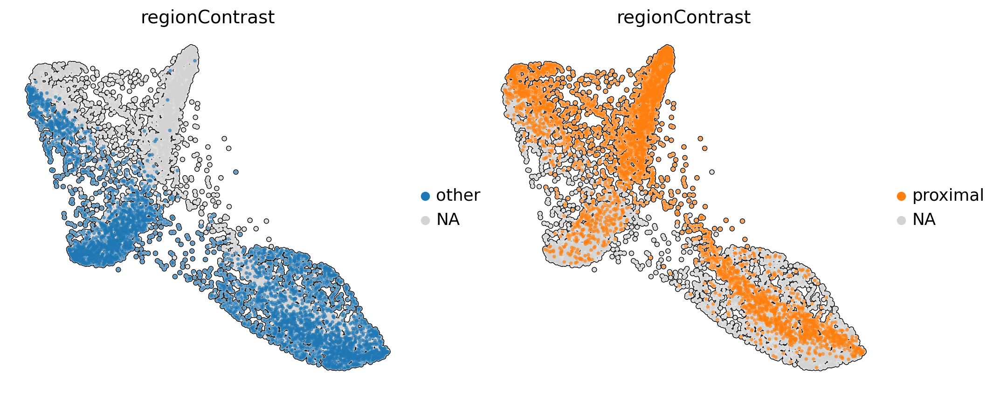

In [39]:
fig, axs = plt.subplots(1,2,figsize=(12, 5) )

for axi, reg in zip(axs.flatten(), adata_no_knn_all.obs.regionContrast.unique()):   
    sc.pl.draw_graph(adata_no_knn_all, color=["regionContrast"] , groups=reg,  size = 30, 
               add_outline = True,outline_width=(0.2, 0.05), frameon=False, show=False, ax=axi)

In [40]:
%%R

.libPaths( c( "./R/x86_64-pc-linux-gnu-library" , .libPaths() ) )

In [41]:
%%R
library(miloR)
library(igraph)
library(ggplot2)
set.seed(0)

In [42]:
%%R -i adata_no_knn_all

d=20
k=15

set.seed(0)

milo <- Milo(adata_no_knn_all)
milo <- buildGraph(milo, k=k, d=d)


In [43]:
%%R -i design_df -o DA_results_Prox_vs_other  -o nhoods_all
set.seed(0)

design_df$type <- as.factor(design_df$type)
design_df$regionContrast <- as.factor(design_df$regionContrast)
design_df$dataset <- as.factor(design_df$dataset)

contrastProx_vs_other <- c("regionContrastproximal - regionContrastother")

#contrastAll <- c("regionContrastproximal - regionContrastotheral")
#contrastAll <- c("regionContrastproximal - regionContrastotheral")



## Define neighbourhoods
milo <- makeNhoods(milo, prop = 1, k = k, d=d, refined = TRUE)

## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="dataset")

## Calculate otherances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=d)

## Test for differential abundance

nhoods_all <- milo@nhoods


DA_results_Prox_vs_other <- testNhoods(milo, design = ~ 0 + regionContrast, design.df = design_df, model.contrast = contrastProx_vs_other)


#DA_results_all <- testNhoods(milo, design = ~ 0 + type, design.df = design_df, model.contrast = contrastPol_vs_CTL)



In [44]:
%%R
set.seed(0)

milo <- buildNhoodGraph(milo)

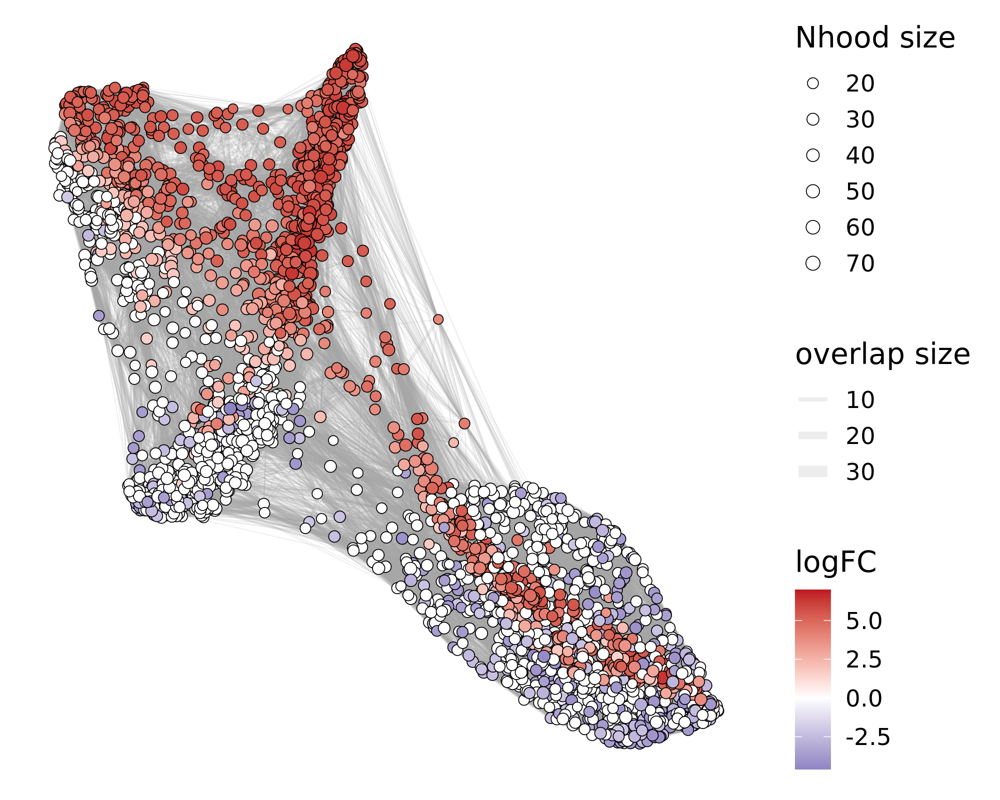

In [45]:
%%R -w 2000 -h 1600 -r 300
set.seed(0)

plotNhoodGraphDA(milo, DA_results_Prox_vs_other,  alpha=.1,size_range=c(2,3), layout="X_draw_graph_fa")+
  scale_fill_gradient2(high='#be1622', mid='white', low="#534ca3", name="logFC")+ theme(
  panel.background = element_rect(fill = "transparent",
                                  colour = NA_character_), # necessary to avoid drawing panel outline
  panel.grid.major = element_blank(), # get rid of major grid
  panel.grid.minor = element_blank(), # get rid of minor grid
  plot.background = element_rect(fill = "transparent",
                                 colour = NA_character_), # necessary to avoid drawing plot outline
  legend.background = element_rect(fill = "transparent"),
)




In [46]:
%%R -i figDir
library(svglite)
library(ggplot2)
ggsave(
  paste0(figDir,"/DA_Proximal_vs_Distal.LINEAGE.pdf"),
  plot = last_plot(),
  device = "pdf",
  scale = 1,bg = "transparent",
  width = 2200,
  height = 1640,
  units = c("p"),
  dpi = 300)

(2842, 7247)


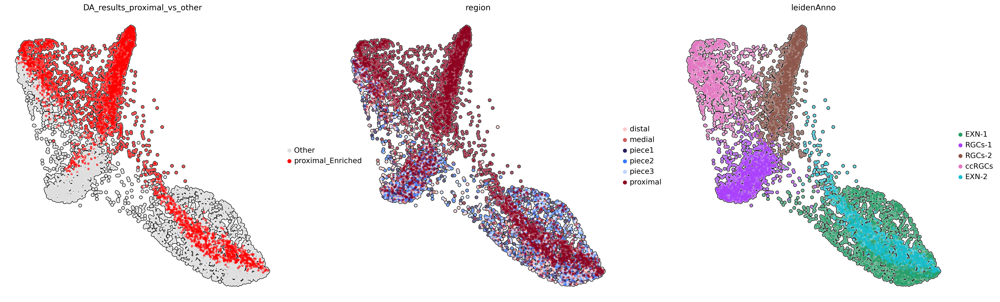

In [47]:
pylab.rcParams['figure.figsize'] = (9, 9)

#Noods to cells DF creation
fdrthresh = .1
absfcthresh = 2.5
Conditionstuple = ("proximal","other")
ResultsDF = DA_results_Prox_vs_other.copy()

conditionColorMap = {Conditionstuple[0]:"#FF0000",
           Conditionstuple[1]:"#0000FF"}


DiffAbundanceCol = "DA_results_{}_vs_{}".format(Conditionstuple[0],Conditionstuple[1])

############################################################

NHoodsDF = pd.DataFrame(nhoods_all.todense(), columns = [str(int(i)) for i in ResultsDF.Nhood.tolist()], index = adata_no_knn_all.obs_names.tolist() ).T
NHoodsDF["logFC"] = ResultsDF.loc[NHoodsDF.index,"logFC"]
NHoodsDF["SpatialFDR"] = ResultsDF.loc[NHoodsDF.index,"SpatialFDR"]
NHoodsDF["Nhood"] = ResultsDF.loc[NHoodsDF.index,"Nhood"]

print(NHoodsDF.shape)

#Not ambigous cells
NHoodsDF["Enrichment"] = np.where(NHoodsDF.logFC > 0, "Enriched","Depleted")
NHoodsDF.groupby("Enrichment").size()
GroupByCells = NHoodsDF[[i for i in NHoodsDF.columns.tolist() if i not in ["logFC","SpatialFDR"]]].groupby(["Enrichment"]).sum()
UniqueCells = GroupByCells.columns[(GroupByCells > 0).sum(axis = 0) == 1]
NHoodsDF = NHoodsDF[[c for c in NHoodsDF.columns if c in UniqueCells]+["logFC","SpatialFDR","Nhood"]]


adata_no_knn_all.obs[DiffAbundanceCol] = "Other"
    
#Enirched cells proimal
NeighbmaskEnr = NHoodsDF.loc[(NHoodsDF["SpatialFDR"] < fdrthresh) & (NHoodsDF["logFC"] > absfcthresh),
                            [c for c in NHoodsDF.columns.tolist() if c not in ["logFC","SpatialFDR","Nhood","Enrichment"] ]]

EnrichedCells = NeighbmaskEnr.columns[NeighbmaskEnr.sum(axis = 0) > 0].tolist()    
adata_no_knn_all.obs.loc[EnrichedCells, DiffAbundanceCol] = "{}_Enriched".format(Conditionstuple[0])




#Map colors
adata_no_knn_all.obs[DiffAbundanceCol] = adata_no_knn_all.obs[DiffAbundanceCol].astype("category")
condList = adata_no_knn_all.obs[DiffAbundanceCol].cat.categories.tolist()

unsColors = condList.copy()
unsColors[condList.index("{}_Enriched".format(Conditionstuple[0]))] = conditionColorMap[Conditionstuple[0]]
unsColors[condList.index("Other")] = "#dedede"
unsColors

adata_no_knn_all.uns[DiffAbundanceCol+"_colors"] = unsColors.copy()


sc.pl.draw_graph(adata_no_knn_all, color=[DiffAbundanceCol,"region", "leidenAnno"] ,size = 70, 
           add_outline = True,outline_width=(0.2, 0.05), frameon=False)


# Tradeseq

In [48]:
#Load data



adataTradeseq = sc.read_h5ad(outdir+'/1_polaroid_mint.h5ad')[adata_no_knn_all.obs_names]
adataTradeseq.obs = adata.obs.loc[adataTradeseq.obs_names].copy()                   
adataTradeseq.obs["DA_results_proximal_vs_other"] = adata_no_knn_all.obs.loc[adataTradeseq.obs_names,"DA_results_proximal_vs_other"]
                                                             
#Trim extreme values of DPT (for potentially low amount of cells)
trimExtremes = [0.01,.91]
minDPT, maxDPT = np.quantile(adataTradeseq.obs["dpt_pseudotime"], [0.01,.99])
adataTradeseq = adataTradeseq[(adataTradeseq.obs["dpt_pseudotime"] > minDPT) & (adataTradeseq.obs["dpt_pseudotime"] < maxDPT)]

#Balance bins 
adataTradeseq.obs["dpt_bin"] = pd.cut(adataTradeseq.obs["dpt_pseudotime"], 100)
minVals = pd.crosstab(adataTradeseq.obs["DA_results_proximal_vs_other"],adataTradeseq.obs["dpt_bin"]).min()

bclist = []
for dptbin in minVals.index.tolist():
    for i in adataTradeseq.obs["DA_results_proximal_vs_other"].unique(): 
        BINcells = adataTradeseq.obs_names[(adataTradeseq.obs["dpt_bin"] == dptbin) & (adataTradeseq.obs["DA_results_proximal_vs_other"] == i)].tolist()
        bclist.extend(random.sample(BINcells, minVals.loc[dptbin]))
        
adataTradeseq = adataTradeseq[bclist]


## Subset genes to test
CuratedmarkersSet = set(CuratedmarkersDF.loc[CuratedmarkersDF.score >= 1,"name"].tolist())
HVGset = set(adata.var_names[adata.var["highly_variable"]])
GenesToTest = list((CuratedmarkersSet.union(HVGset)).intersection(set(sc.read_h5ad(outdir+'/1_polaroid_mint.h5ad').var_names)))
adataTradeseq = adataTradeseq[:,GenesToTest]
adataTradeseq.shape

Trying to set attribute `.obs` of view, copying.


(4302, 3224)

In [49]:
LineagesOrder = ["proximal_Enriched","Other"]




cellWeights = pd.get_dummies(adataTradeseq.obs["DA_results_proximal_vs_other"])[LineagesOrder]
cellWeights = np.matrix(cellWeights.to_numpy())


pseudotime = adataTradeseq.obs["dpt_pseudotime"]
pseudotime = pd.DataFrame({LineagesOrder[0]:pseudotime,LineagesOrder[1]:pseudotime})
pseudotime = np.matrix(pseudotime.to_numpy())

# Transpose needed!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
counts = adataTradeseq.X.T.todense()
counts = counts + abs(counts.min())

varnames = adataTradeseq.var_names.tolist()

In [50]:
import anndata2ri
import rpy2
anndata2ri.activate()
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [51]:
%%R -i cellWeights -i pseudotime -i counts -i varnames 
set.seed(0)

library(tradeSeq)
library(ggplot2)
library(stats)

set.seed(0)

#rownames(counts) <- varnames

w <- as.matrix(cellWeights)
dpt <- as.matrix(pseudotime)
cMatrix <- as.matrix(counts)


In [52]:
%%R

gamObj <- fitGAM(cMatrix, verbose = TRUE, pseudotime = dpt, cellWeights = w, nknots = 7, sce=FALSE, parallel=FALSE)
names(gamObj) <- varnames



  |                                                  | 0 % ~calculating   |+                                                 | 1 % ~11m 15s       |++                                                | 2 % ~11m 02s       |++                                                | 3 % ~10m 58s       |+++                                               | 4 % ~10m 55s       |+++                                               | 5 % ~10m 36s       |++++                                              | 6 % ~10m 35s       |++++                                              | 7 % ~11m 14s       |+++++                                             | 8 % ~10m 55s       |+++++                                             | 9 % ~10m 40s       |++++++                                            | 10% ~10m 38s       |++++++                                            | 11% ~10m 35s       |+++++++                                           | 12% ~10m 24s       |+++++++                                           | 13% ~10m 

# Pattern differences 

In [53]:
%%R

source("./data/resources/tradeSeq-utils/utils.R")



In [54]:
%%R

topGenesToUse=1000




In [55]:
%%R  -o patternResSS -o patternResSSPandas -i LineagesOrder


patternRes <- patternTest(gamObj)
patternRes$bonferroni <- p.adjust(patternRes$pvalue, method = "bonferroni", n = length(patternRes$pvalue))
patternResSS = patternRes[patternRes$bonferroni < 0.01,]



datalist = c()


for (g in rownames(head(patternResSS[order(patternResSS$waldStat, decreasing = TRUE),],topGenesToUse))){
    
    localModel <- gamObj[[g]]    
    data <- localModel$model    
    y <- data$y
    nCurves <- length(localModel$smooth)

    for (jj in seq_len(nCurves)) {
        df <- .getPredictRangeDf(localModel$model, jj, nPoints = 100)
        yhat <- predict(localModel, newdata = df, type = "response")

        Newframe <- data.frame("fittedCounts" = yhat)
        colnames(Newframe) <- c(paste0("fittedCounts.",g,".",replace(as.character(jj), as.character(jj), LineagesOrder[jj])[[2]]))

        datalist[[paste(g,jj)]] <- Newframe


    }

}

patternResSSPandas =  do.call(cbind, datalist)





# Explore output

## Pattern Diffs

In [56]:
leidenOrder = ["ccRGCs", 'RGCs-1', 'RGCs-2', 'EXN-1','EXN-2']
leidenCols = dict(zip(leidenOrder,
                 adata.uns["leidenAnno_colors"][adataTradeseq.obs.leidenAnno.cat.categories.get_indexer_for(leidenOrder)]))
leidenCols

{'ccRGCs': '#e377c2',
 'RGCs-1': '#aa40fc',
 'RGCs-2': '#8c564b',
 'EXN-1': '#279e68',
 'EXN-2': '#17becf'}

Markers with differential pattern Found are  ['CADM1', 'ROBO2', 'FGF13', 'EPHA3', 'SPRY1', 'TENM1']


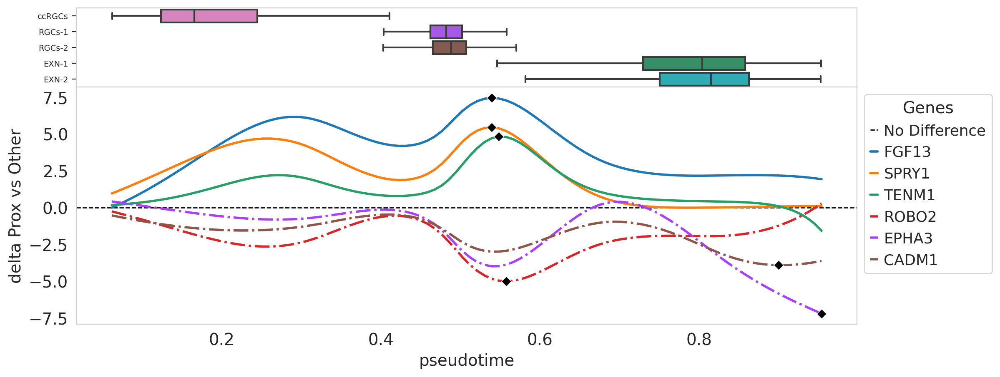

In [57]:
#Curatedmarkerslist = CuratedmarkersDF.loc[CuratedmarkersDF.score > 1,"name"].tolist()
#CuratedmarkersDF = pd.read_csv(markers, header=None, sep = "\t", names=["name","area","score"])
#Curatedmarkerslist = CuratedmarkersDF.loc[CuratedmarkersDF.score >= 1,"name"].tolist()
Curatedmarkerslist = ["TENM1", "SPRY1", "FGF13", "EPHA3", "ROBO2", "CADM1"]

##############################
CommonMArkersFound = list(set(Curatedmarkerslist).intersection(set([i.split(".")[1] for i in patternResSSPandas.columns.tolist()])))
print("Markers with differential pattern Found are ",CommonMArkersFound)

MarkersMap = CuratedmarkersDF[CuratedmarkersDF.name.isin(CommonMArkersFound)]
cmapTemp = pyplot.get_cmap('Blues', MarkersMap[MarkersMap.area == "Temporal"].shape[0]+2)    
cmapTemp = [colors.rgb2hex(cmapTemp(i)) for i in range(cmapTemp.N)][2:]
MarkersMap.loc[MarkersMap.area=="Temporal","Color"] = "pink"

cmapFrontal = pyplot.get_cmap('Reds', MarkersMap[MarkersMap.area == "Frontal"].shape[0]+2)   
cmapFrontal = [colors.rgb2hex(cmapFrontal(i)) for i in range(cmapFrontal.N)][2:]
MarkersMap.loc[MarkersMap.area=="Frontal","Color"] = "#be1622"

MarkersColMap = dict(zip(MarkersMap.name.tolist(), MarkersMap.Color.tolist()))
MarkerStyle = {"Frontal":"-","Temporal":"-."}
###################à



sns.set_style("whitegrid", {'axes.grid' : False})



fig, axes = plt.subplots(2,1, figsize=(12,5),sharex=True, 
                         gridspec_kw={'height_ratios': [1, 3]})



leidenOrder = ["ccRGCs", 'RGCs-1', 'RGCs-2', 'EXN-1','EXN-2']
leidenCols = dict(zip(leidenOrder,
                 adata.uns["leidenAnno_colors"][adataTradeseq.obs.leidenAnno.cat.categories.get_indexer_for(leidenOrder)]))
                 
sns.boxplot(data=adataTradeseq.obs, x="dpt_pseudotime", y="leidenAnno", ax = axes[0],
            palette=leidenCols,
            showfliers=False,order=["ccRGCs", 'RGCs-1', 'RGCs-2', 'EXN-1','EXN-2'])


axes[1].axhline( y=0, linewidth=1,  color="black", ls='--', label="No Difference")


for m in MarkersMap.sort_values("area").name.tolist():
    
    cList = [c for c in patternResSSPandas.columns.tolist() if "."+m+"." in c]
    cList = [i for i in cList if ".proximal_Enriched" in i]+[i for i in cList if ".Other" in i]
    if len(cList ) > 0:

        SmoothedExpr = patternResSSPandas[cList].copy()
        SmoothedExpr["pseudotime"] = SmoothedExpr.index.tolist()      
        SmoothedExpr["pseudotime"] =  np.linspace(minDPT,maxDPT, 100)
        SmoothedExpr["delta Prox vs Other"] = SmoothedExpr.iloc[:,0] - SmoothedExpr.iloc[:,1]
        
        #TrimExtremes
        

        if abs(SmoothedExpr["delta Prox vs Other"]).max() > 15:
            continue
        
        sns.lineplot(data=SmoothedExpr, x="pseudotime", y="delta Prox vs Other", linewidth=2, ax=axes[1],label=str(m),
                     linestyle=MarkerStyle[MarkersMap.loc[MarkersMap.name == m,"area"].values[0]])
        #axes[1].lines[1].set_linestyle("--")
        
        sns.scatterplot(x=[SmoothedExpr.loc[abs(SmoothedExpr["delta Prox vs Other"]).idxmax(),"pseudotime"]],
                y=[SmoothedExpr.loc[abs(SmoothedExpr["delta Prox vs Other"]).idxmax(),"delta Prox vs Other"]], ax=axes[1], color="black",zorder=10,marker="D")
        
        fig.show()


axes[1].legend(title='Genes', bbox_to_anchor=(1, 1))

#plt.setp(axes[0].get_yticklabels()[0], visible=False)  
axes[0].yaxis.set_label_position("left")
axes[0].set_yticklabels(leidenOrder, size=7, visible=True)
axes[0].yaxis.tick_left()
axes[0].set_ylabel("", visible=False)
axes[0].set_position([0.1,0.1,1,1])
fig.subplots_adjust(hspace=0)

fig.savefig(figDir+'/Deltas.pdf',bbox_inches='tight')



